In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from tqdm import tqdm_notebook
from sklearn.metrics import r2_score

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
housedf = pd.read_csv("kc_house_data.csv")

In [4]:
# check for null, missing values 
housedf.isnull().sum(axis = 0)

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [5]:
housedf.dtypes

id                 int64
date              object
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

In [6]:
# sqft variables and price to float (since continuous data type)
housedf.sqft_living = (housedf.sqft_living).astype(float)
housedf.sqft_lot = (housedf.sqft_lot).astype(float)
housedf.sqft_above = (housedf.sqft_above).astype(float)
housedf.sqft_basement = (housedf.sqft_basement).astype(float)
housedf.price = (housedf.price).astype(float)

#change date to datetime
housedf.date = pd.to_datetime(housedf['date'])

#Change condition, grade to factors
housedf.condition = (housedf.condition).astype('category')

#Deleting the ID column
housedf = housedf.drop(['id'], axis = 1)

In [7]:
housedf.dtypes

date             datetime64[ns]
price                   float64
bedrooms                  int64
bathrooms               float64
sqft_living             float64
sqft_lot                float64
floors                  float64
waterfront                int64
view                      int64
condition              category
grade                     int64
sqft_above              float64
sqft_basement           float64
yr_built                  int64
yr_renovated              int64
zipcode                   int64
lat                     float64
long                    float64
sqft_living15             int64
sqft_lot15                int64
dtype: object

In [8]:
# Exploring outliers
housedf.describe()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


array([[<AxesSubplot:title={'center':'date'}>,
        <AxesSubplot:title={'center':'price'}>,
        <AxesSubplot:title={'center':'bedrooms'}>,
        <AxesSubplot:title={'center':'bathrooms'}>],
       [<AxesSubplot:title={'center':'sqft_living'}>,
        <AxesSubplot:title={'center':'sqft_lot'}>,
        <AxesSubplot:title={'center':'floors'}>,
        <AxesSubplot:title={'center':'waterfront'}>],
       [<AxesSubplot:title={'center':'view'}>,
        <AxesSubplot:title={'center':'grade'}>,
        <AxesSubplot:title={'center':'sqft_above'}>,
        <AxesSubplot:title={'center':'sqft_basement'}>],
       [<AxesSubplot:title={'center':'yr_built'}>,
        <AxesSubplot:title={'center':'yr_renovated'}>,
        <AxesSubplot:title={'center':'zipcode'}>,
        <AxesSubplot:title={'center':'lat'}>],
       [<AxesSubplot:title={'center':'long'}>,
        <AxesSubplot:title={'center':'sqft_living15'}>,
        <AxesSubplot:title={'center':'sqft_lot15'}>, <AxesSubplot:>]],
      dtype

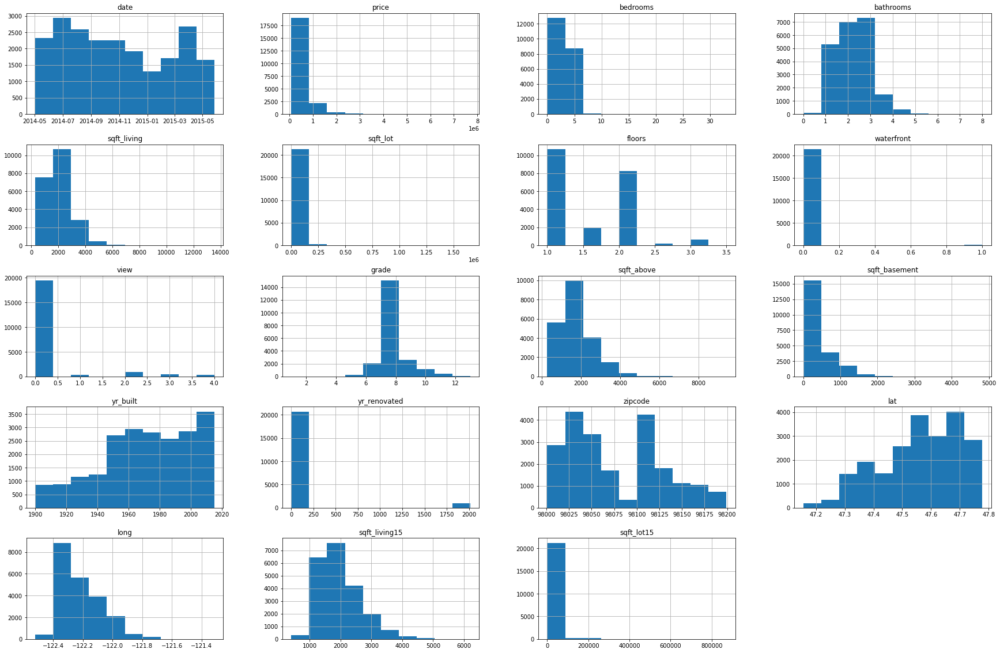

In [9]:
housedf.hist(figsize = (30,20))

In [10]:
# 33 bedrooms is a typo and recoding to 3 bedrooms compared to other 3 bedrooms with similar attributes
housedf.loc[housedf['bedrooms'] == 33, 'bedrooms'] = 3

In [11]:
housedf.describe()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,5.400881e+05,3.369454,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,3.671272e+05,0.907964,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,7.700000e+06,11.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


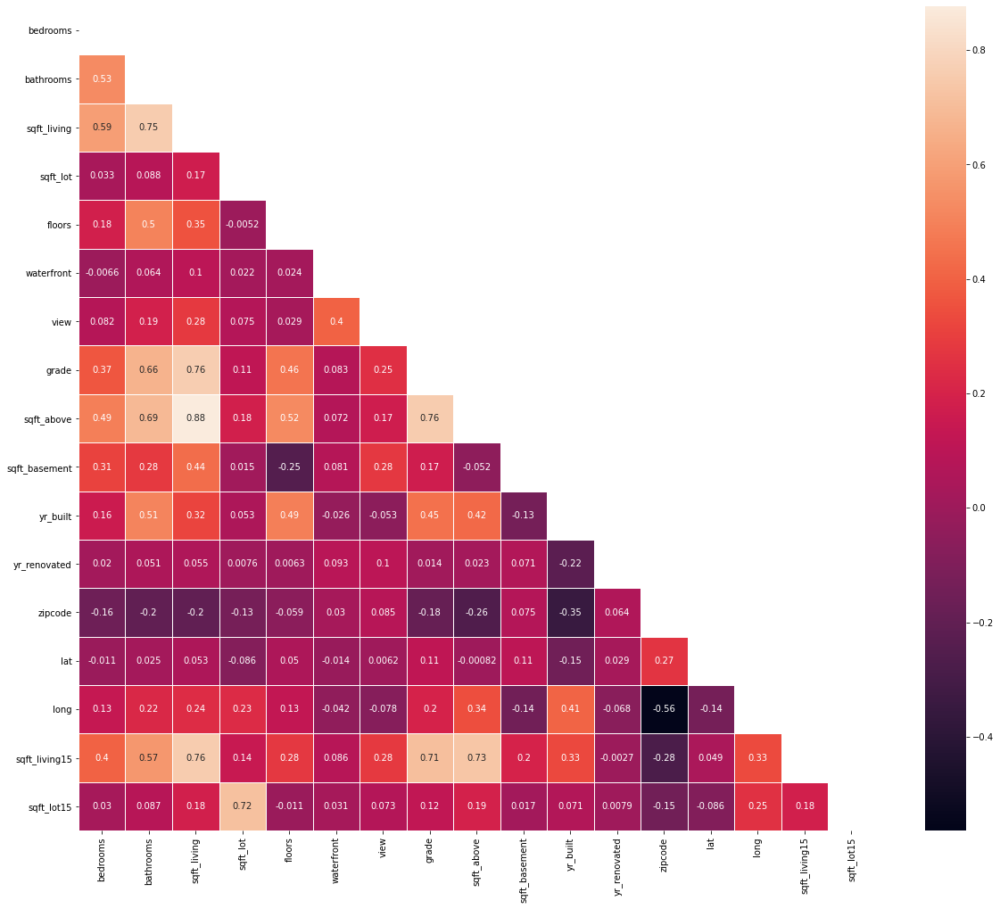

In [12]:
# finding correlation among variables other than price
corr_data = housedf.drop(['price'], axis = 1)
plt.figure(figsize=(20, 17))
matrix = np.triu(corr_data.corr())
sns.heatmap(corr_data.corr(), annot=True,
            linewidth=.8, mask=matrix, cmap="rocket");

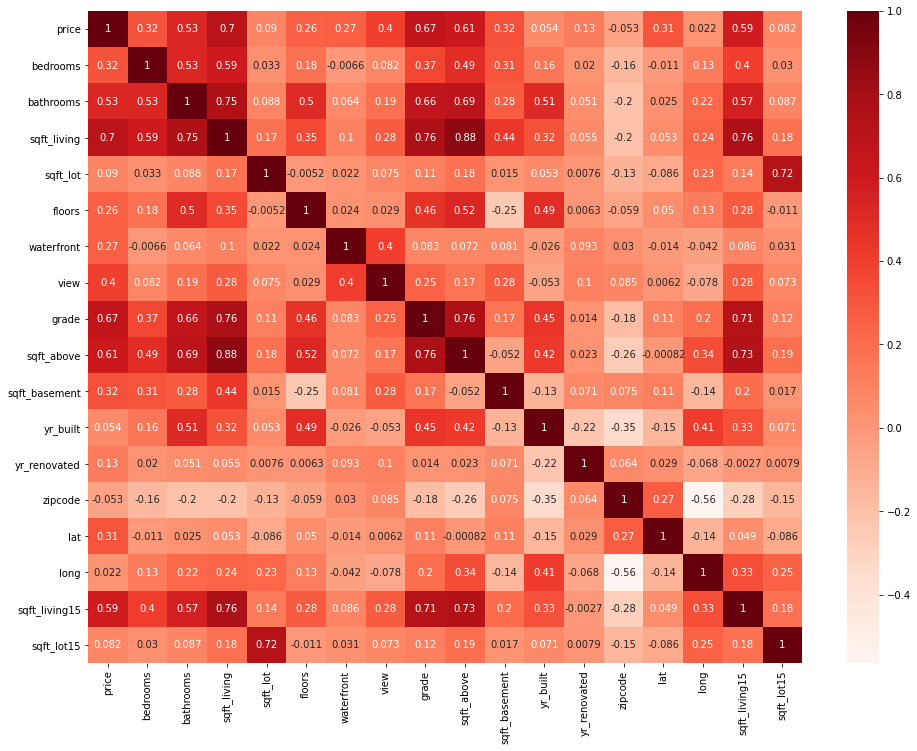

In [13]:
# Correlation of price variable with all other variables
cor = housedf.corr()
plt.figure (figsize = (16,12))
sns.heatmap(cor, annot = True, cmap = plt.cm.Reds)
plt.show()

In [14]:
housedf.corr()['price'].sort_values(ascending = False)

price            1.000000
sqft_living      0.702035
grade            0.667434
sqft_above       0.605567
sqft_living15    0.585379
bathrooms        0.525138
view             0.397293
sqft_basement    0.323816
bedrooms         0.315438
lat              0.307003
waterfront       0.266369
floors           0.256794
yr_renovated     0.126434
sqft_lot         0.089661
sqft_lot15       0.082447
yr_built         0.054012
long             0.021626
zipcode         -0.053203
Name: price, dtype: float64

In [15]:
# EDA , Distribution plots
def distributionPlot(dataset):
    fig = plt.figure(figsize=(20, 20))
    for i in tqdm_notebook(range(len(dataset.columns)), desc = 'Generating Distribution Plots'):
        fig.add_subplot(np.ceil(len(dataset.columns)/5), 5, i+1)
        sns.distplot(
            dataset.iloc[:, i], color="red", rug=True)
        fig.tight_layout(pad=3.0)



Generating Distribution Plots:   0%|          | 0/20 [00:00<?, ?it/s]

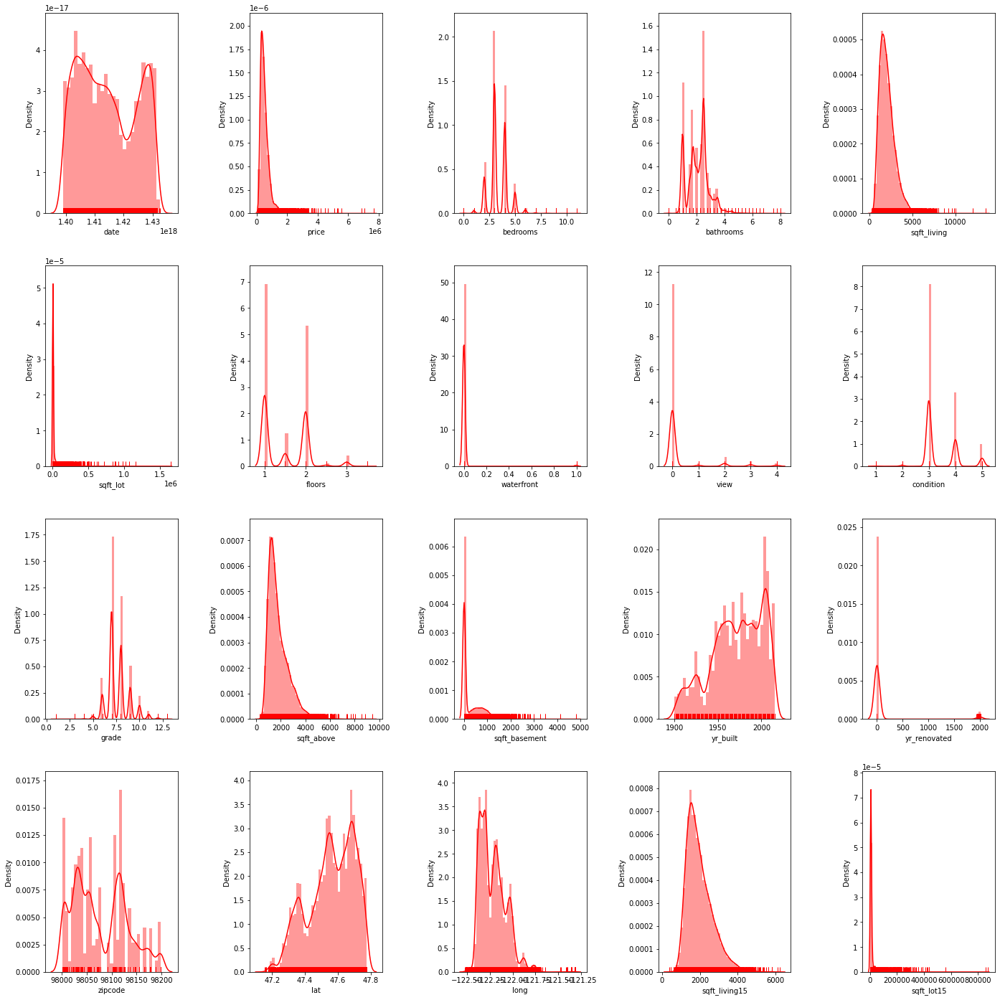

In [16]:
distributionPlot(housedf)

In [17]:
# EDA, histograms
def countPlotter(dataset):
    fig = plt.figure(figsize=(20, 20))
    for i in tqdm_notebook(range(len(dataset.columns)), desc = 'Generating Count Plots'):
        if not dataset.columns[i] == 'price':
            fig.add_subplot(np.ceil(len(dataset.columns)/2), 2, i)
            sns.countplot(dataset[dataset.columns[i]],
                          order=dataset[dataset.columns[i]].value_counts().index)

            fig.tight_layout(pad=3.0)

In [18]:
plot_data = housedf.drop(['date', 'sqft_living15', 'sqft_lot15', 'lat', 'long', 'sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode'], axis = 1)

Generating Count Plots:   0%|          | 0/8 [00:00<?, ?it/s]

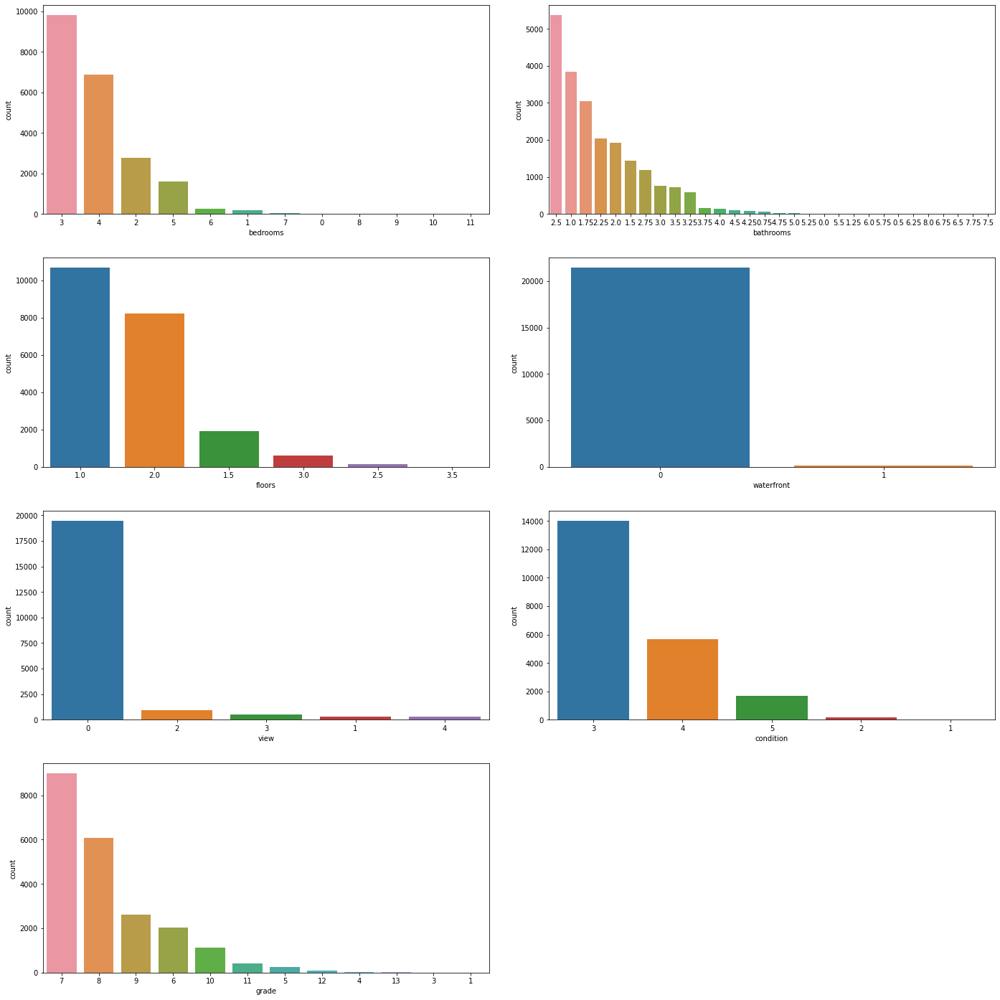

In [19]:
countPlotter(plot_data)

In [20]:
#Bi-variate analysis of price with above columns
def groupBarPlotter(dataset):
    fig = plt.figure(figsize=(20, 20))
    for i in tqdm_notebook(range(len(dataset.columns)), desc = 'Generating Group Plots'):
        if not dataset.columns[i] == 'price':
            groups = dataset.groupby(dataset.columns[i])['price'].mean()
            fig.add_subplot(np.ceil(len(dataset.columns)/2), 2, i)
            plt.xlabel('price')
            groups.plot.barh()
            fig.tight_layout(pad=3.0)

Generating Group Plots:   0%|          | 0/8 [00:00<?, ?it/s]

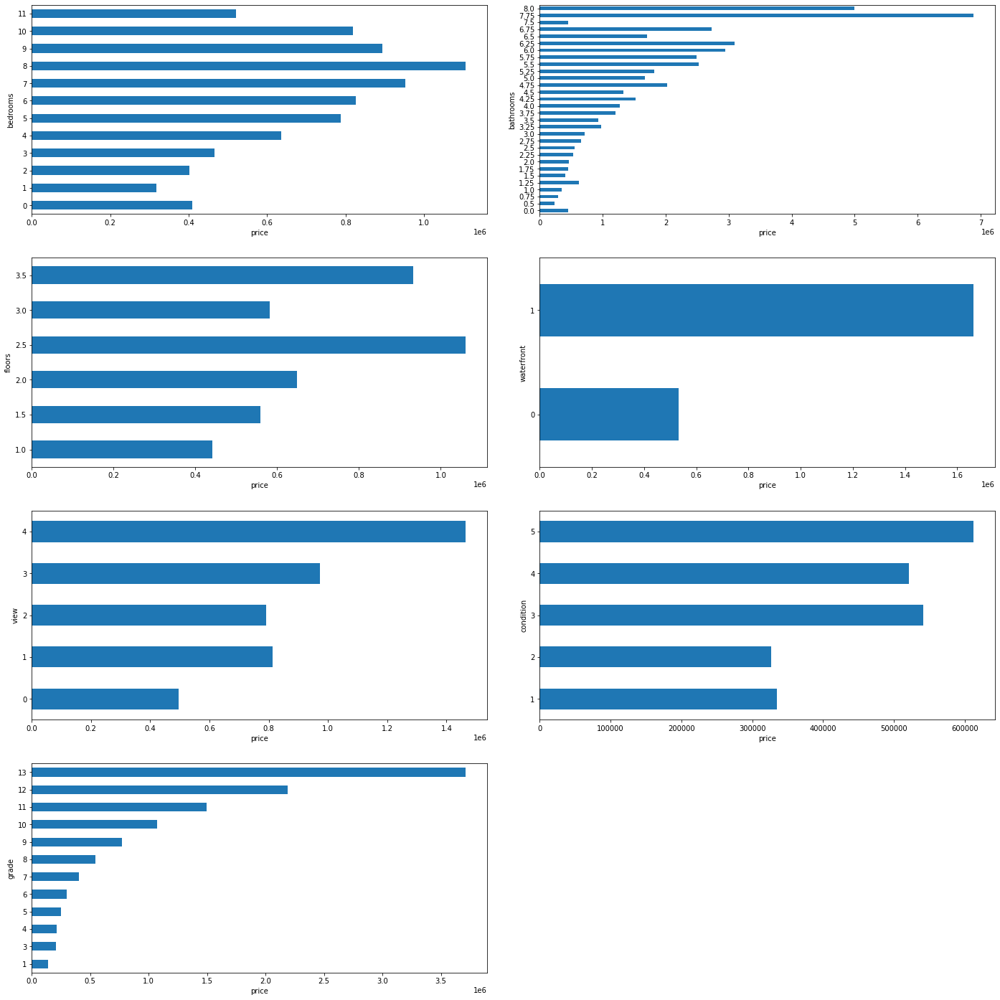

In [21]:
#price is positively correlated to number of bathrooms,waterfront,view,condition and grade
groupBarPlotter(plot_data)

In [22]:
housedf.describe()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,5.400881e+05,3.369454,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,3.671272e+05,0.907964,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,7.700000e+06,11.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


<AxesSubplot:xlabel='price', ylabel='Density'>

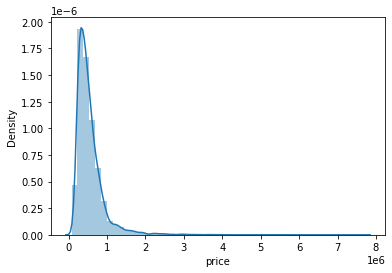

In [23]:
#Density plot of price
sns.distplot(housedf['price'])

In [24]:
housedf['log_price'] = np.log(housedf['price'])

<AxesSubplot:xlabel='log_price', ylabel='Density'>

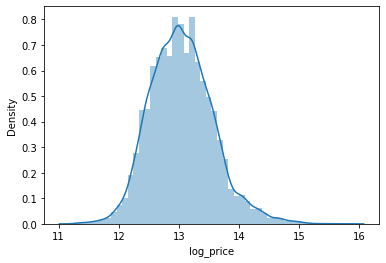

In [25]:
sns.distplot(housedf['log_price'])

In [26]:
housedf['log_sqft_living'] = np.log(housedf['sqft_living'])
housedf['log_sqft_lot'] = np.log(housedf['sqft_lot'])
housedf['log_sqft_above'] = np.log(housedf['sqft_above'])
housedf['log_sqft_living15'] = np.log(housedf['sqft_living15'])
housedf['log_sqft_lot15'] = np.log(housedf['sqft_lot15'])

In [40]:
testdf = housedf.drop(["log_price","date","sqft_living", "sqft_lot", "sqft_above", "sqft_living15", "sqft_lot15" ], axis = 1)
testdf.dtypes

price                 float64
bedrooms                int64
bathrooms             float64
floors                float64
waterfront              int64
view                    int64
condition            category
grade                   int64
sqft_basement         float64
yr_built                int64
yr_renovated            int64
zipcode                 int64
lat                   float64
long                  float64
log_sqft_living       float64
log_sqft_lot          float64
log_sqft_above        float64
log_sqft_living15     float64
log_sqft_lot15        float64
dtype: object

In [41]:
#Geo-spatial analysis
import folium
from branca.element import Figure

seattlemap_fig=Figure(width=750,height=450)
zipcode_waterfront = housedf.groupby("zipcode")[["waterfront"]].mean().reset_index()

seattle_map = folium.Map(location=[47.6062, -122.3321 ], zoom_start=7)
seattlemap_fig.add_child(seattle_map)

folium.Choropleth(
    geo_data='https://opendata.arcgis.com/datasets/06da0f67fc1948e3aae93063750ad02b_790.geojson',
    data=zipcode_waterfront,
    columns=['zipcode', 'waterfront'],
    key_on='feature.properties.ZIP',
#     fill_color='YlOrRd', 
    nan_fill_color = "#ffffff",
    fill_opacity=1, 
    line_opacity=1,
    smooth_factor=0
).add_to(seattle_map)

seattle_map

In [42]:
from sklearn.feature_selection import RFECV, SelectFromModel
from sklearn.preprocessing import StandardScaler, OneHotEncoder, PolynomialFeatures
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV, RandomizedSearchCV
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, BaggingRegressor, AdaBoostRegressor, ExtraTreesRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from tqdm import tqdm


In [43]:
# Train-Test-Validation Split, 60-20-20
X= testdf.drop(['log_price'], axis = 1)
y = testdf['log_price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .2, random_state = 42)
X_train, X_dev, y_train, y_dev = train_test_split(X_train, y_train, test_size = .25, random_state = 42)

KeyError: "['log_price'] not found in axis"

In [ ]:
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X,Y)
print(f'R2 Score : {r2_score(Y, lin_reg.predict(X))* 100}')

In [ ]:
#Decision Tree
from sklearn.tree import DecisionTreeRegressor
r_dt = DecisionTreeRegressor(random_state=0)
r_dt.fit(X,Y)

print(f'R² score: {r2_score(Y, r_dt.predict(X))*100}')

In [ ]:
# Random Forest
from sklearn.ensemble import RandomForestRegressor
rf_reg=RandomForestRegressor(n_estimators = 10,random_state=0)
rf_reg.fit(X,Y.ravel())

print(f'R² score: {r2_score(Y, rf_reg.predict(X))*100}')

In [ ]:
def model_evaluation(clf, X_train, X_test, y_train, y_test, scoring=[mean_squared_error, mean_absolute_error, r2_score],
                     columns = ["mse", "mae", "r2"], trainvstest = True ,graph = True, rmse = True, return_table = True, log=False):
        hist = []
        pred_train = clf.predict(X_train)
        pred_test = clf.predict(X_test)
        
        
        if log: # Since y label is log scaled
            y_train = np.exp(y_train) # Inverse Log Scale for training data
            pred_train = np.exp(pred_train) # Inverse of Log Scale for training set
            pred_test = np.exp(pred_test) # Inverse of Log Scale for training set
        
        for score in scoring:
            if rmse and score == mean_squared_error:
                if trainvstest: # if compare both train and test set
                   hist.append(round(score(y_train, pred_train, squared=False),2))
                hist.append(round(score(y_test, pred_test, squared=False),2))
                continue
            if trainvstest:
                hist.append(round(score(y_train, pred_train),2))
            hist.append(round(score(y_test, pred_test),2))
        cols = columns.copy()
        if rmse:
            try:
                cols[cols.index("mse")] = 'rmse'
            except:
                assert False,"Mean Squared Error is missing from columns"
            
        if trainvstest:
            cols = np.array([["train_"+col, "test_"+col] for col in cols]).flatten()
        
        if graph:
            fig, ax = plt.subplots(figsize=(7,7))
            plt.scatter(y_test, pred_test, c='crimson')
            p1 = max(max(pred_test), max(y_test))
            p2 = min(min(pred_test), min(y_test))
            plt.plot([p1, p2], [p1, p2], 'b-')
            plt.xlabel('True Values', fontsize=15)
            plt.ylabel('Predictions', fontsize=15)
            ax.set_aspect('equal')
            plt.show()
            
        if return_table:
            return pd.DataFrame([hist], columns=cols, index = [type(clf).__name__])
        else:
            return type(clf).__name__, hist, cols

In [44]:
def models_selection(clfs:list, X_train, X_test, y_train, y_test, 
                     scoring=[mean_squared_error, mean_absolute_error, r2_score],
                     columns = ["mse", "mae", "r2"], trainvstest = True,
                     graph = False, rmse = True, return_table = False):
    hists = []
    model_names = []
    for clf in tqdm(clfs):
        clf.fit(X_train, y_train)
        model_name, hist, col_name = model_evaluation(clf, X_train, X_test, y_train, y_test, 
                         scoring=scoring,columns = columns, trainvstest = trainvstest,
                         graph = graph, rmse = rmse, return_table = return_table)
        model_names.append(model_name)
        hists.append(hist)
    
    return pd.DataFrame(hists, columns = col_name, index = model_names)


In [45]:
models = [
    LinearRegression(),#linear_model
    KNeighborsRegressor(), #Eucilidean distance model
    DecisionTreeRegressor(random_state = 12), #tree model
    RandomForestRegressor(random_state = 12), #ensemble tree models
]
models_selection(models, X_train, X_test, y_train, y_test)

100%|██████████| 4/4 [00:15<00:00,  3.90s/it]


,train_rmse,test_rmse,train_mae,test_mae,train_r2,test_r2
LinearRegression,0.25,0.25,0.19,0.19,0.77,0.77
KNeighborsRegressor,0.29,0.37,0.20,0.26,0.70,0.51
DecisionTreeRegressor,0.02,0.25,0.00,0.18,1.00,0.77
RandomForestRegressor,0.07,0.18,0.05,0.13,0.98,0.89
